# SCRIPT FOR ANALYSIS OF CELLS ANALYZED WITH Xenium

This notebook is used to identify cell populations from Xenium datasets. The analysis is based on Scanpy (documentation in  https://scanpy.readthedocs.io/en/stable/index.html) and Squidpy (documentation in https://squidpy.readthedocs.io/en/stable/)

Specifically, in this notebook we analyze the expanded output of Xenium. We will later on use it to compare this clusters with the ones resulting from nuclei segmentation

## Loading the packages

We import the packages needed for it. If something fails, means that we haven't installed something in the environment

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import xb.plotting as xp
from xb.plotting import map_of_clusters

## Importing the data and creating an anndata object

We import the adata object for each of the three technical replicates. We remove articitial/control genes and we add a tag to every cell to distinguish the replicate they are comming from

In [2]:
adata1=sc.read(r"../../data/unprocessed_adata/ms_brain_multisection1.h5ad")

In [3]:
adata1.uns['spots']=[]

In [4]:
adata1=adata1[:,adata1.var['in_panel'].isin(['gene'])]
adata1.obs['replicate']='1'

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  


In [8]:
adata2=sc.read(r"../../data/unprocessed_adata/ms_brain_multisection2.h5ad")
adata2.uns['spots']=[]
adata2=adata2[:,adata2.var['in_panel'].isin(['gene'])]
adata2.obs['replicate']='2'

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  after removing the cwd from sys.path.


In [9]:
adata3=sc.read(r"../../data/unprocessed_adata/ms_brain_multisection3.h5ad")
#adata3.uns['spots']=[]
adata3=adata3[:,adata3.var['in_panel'].isin(['gene'])]
adata3.obs['replicate']='3'

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  after removing the cwd from sys.path.


We make gene freq.by replicate plots

In [10]:
adata=sc.concat([adata1,adata2,adata3])

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [11]:
adata.obs['total_counts']=adata.obs['transcript_counts']

In [ ]:
saving_path=r'../../data/processed_adata/'
adata.write(saving_path+'/adata_msbrain_multisection.h5ad')

In [ ]:
saving_path=r'../../data/processed_adata/'
adata=sc.read(saving_path+'/adata_msbrain_multisection.h5ad')

# Combining objects

In [9]:
reading_path=r'../../data/unprocessed_adata'
adata_realmouse1=sc.read(reading_path+'/realmouse_1.h5ad')
adata_realmouse1.obs['replicate']='hm1'
reading_path=r'../../data/unprocessed_adata'
adata_realmouse2=sc.read(reading_path+'/realmouse_2.h5ad')
adata_realmouse2.obs['replicate']='hm2'
reading_path=r'../../data/unprocessed_adata'
adata_realmouse3=sc.read(reading_path+'/realmouse_3.h5ad')
adata_realmouse3.obs['replicate']='hm3'
reading_path=r'../../data/unprocessed_adata'
adata_realmouse4=sc.read(reading_path+'/realmouse_4.h5ad')
adata_realmouse4.obs['replicate']='hm4'

In [10]:
adata_realmouse=sc.concat([adata_realmouse1,adata_realmouse2,adata_realmouse3,adata_realmouse4])

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [11]:
adata_realmouse.write(saving_path+'/realmouse_all.h5ad')

In [12]:
adata_realmouse

AnnData object with n_obs × n_vars = 624353 × 541
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'replicate'

In [13]:
saving_path=r'../../data/processed_adata/'
adata_multi=sc.read(saving_path+'/adata_msbrain_multisection.h5ad')

In [15]:
adata=sc.concat([adata_multi,adata_realmouse])

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/anndata/_core/merge.py:945: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  UserWarning,


In [16]:
saving_path=r'../../data/processed_adata/'
adata.write(saving_path+'/adata_msbrain_multisection_&hm_expanded.h5ad')

# Processing the adata

In [18]:
sc.pp.filter_cells(adata,min_counts=40)
sc.pp.filter_cells(adata,min_genes=15)

We now save the raw data in adata.raw and apply normalization and log-transformation to minimize the effect of outliers. We also scale the data to give the same importance to all genes in clustering

In [20]:
adata.raw=adata

In [21]:
adata.layers['raw']=adata.X
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

[OPTIONAL] After normalizing and logmarizing, the data we CAN, if we wish, filter only highly variable genes for clustering. This step is key in the analysis of single cell RNA sequencing datasets (with +20.000 genes) but it's not that useful in targeted methods such as ISS. However, it can help to keep variables only for clustering

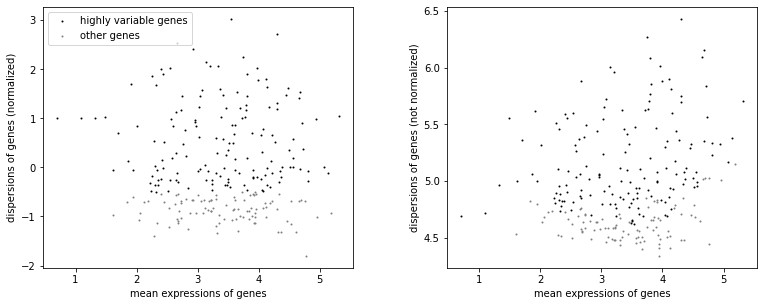

In [22]:
plt.rcParams['figure.facecolor'] = 'white'
sc.pp.highly_variable_genes(adata, min_mean=0.3, max_mean=7, min_disp=-0.5)
sc.pl.highly_variable_genes(adata)

[OPTIONAL] We can also scale the data. This means that we scale the expression of every gene between 0 and 1. This will give decrease the impact of highly expressed genes and will increase the importance of lowly expressed genes. Let's not scale in this case

In [23]:
#sc.pp.scale(adata,max_value=100)

# Dimensional reduction and clustering

We apply principal component analysis to find the appropiate nubmer of components to use to perform dimensionality reduction and clustering

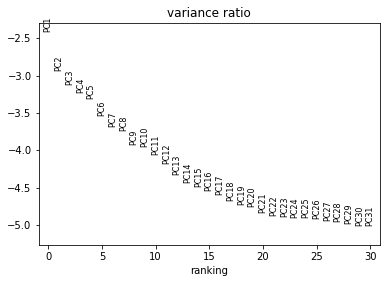

In [24]:
sc.tl.pca(adata, svd_solver='arpack')
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.pca_variance_ratio(adata, log=True)

We select to go with the top X first principal components to look for the nearest neighbors. We are going to represent our data using graph-based methods, like UMAP. For this, we first need to create a graph by linking each cell to the n closest neighbors (n_neighbors) in the dataset. We can select the numbers of principal components to use

In [25]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=0)

We can, then, run clustering, by calling either leiden or louvain clustering. By changing the parameter "resolution" we will generate more or less clusters. Higher resolution means more clusters. The clusters (groups of cells) are indepent from its visualization, which we will create using UMAP later on

In [26]:
sc.tl.leiden(adata,resolution=2.2,key_added='leiden_2_2')
sc.tl.leiden(adata,resolution=1.4,key_added='leiden_1_4')
sc.tl.leiden(adata,resolution=0.6,key_added='leiden_0_6')

To VISUALIZE the diversity of our cells, We perfrom UMAP. The closest two spots are in UMAP, the more similar they will be. With the comand sc.tl.umap. we CALCULATE the UMAP embedding. With sc.pl.umap will VISUALIZE the UMAP.

In [27]:
sc.tl.umap(adata,min_dist=0.1)

On top of the UMAP you can visualize any variable that you might be interested (a metadata column or gene expression). We need to modify the parameter "color" to visualize the appropiate variable on the UMAP

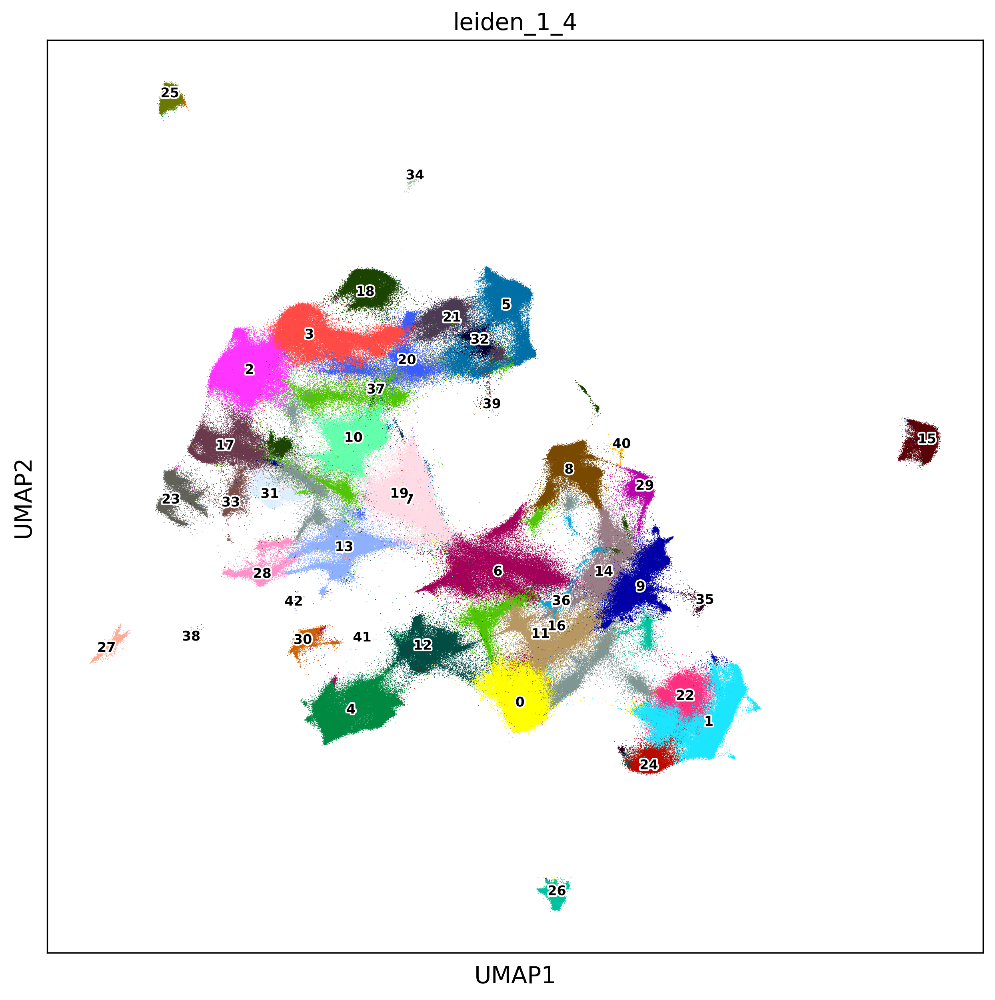

In [28]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['leiden_1_4'],size=1,legend_loc='on data',legend_fontsize=8,legend_fontoutline=2,show=True)

<AxesSubplot:title={'center':'replicate'}, xlabel='UMAP1', ylabel='UMAP2'>

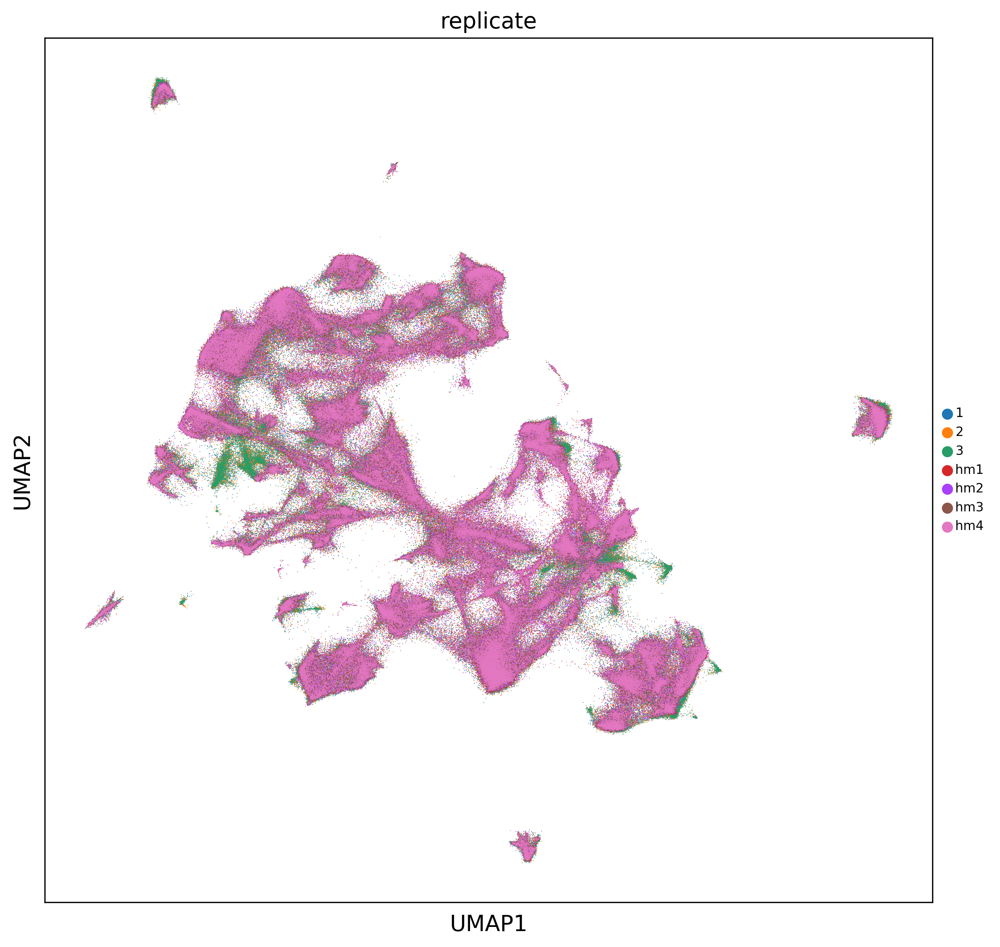

In [31]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['replicate'],size=1,legend_fontsize=8,legend_fontoutline=2,show=False)
#plt.savefig('../../figures/celltype_identification_multisection/msbrain_multisection_leiden_1_4_ondata_nuclei.pdf',bbox_inches='tight')

Plot clusters spatially

In [ ]:
adata.obs['X']=adata.obs['x_centroid']*4.70588
adata.obs['Y']=adata.obs['y_centroid']*4.70588
adata.obs['X_umap']=list(pd.DataFrame(adata.obsm['X_umap'])[0])
adata.obs['Y_umap']=list(pd.DataFrame(-adata.obsm['X_umap'])[1])
adata.obs['replicate'].unique()
for rep in adata.obs['replicate'].unique():
    adatasub=adata[adata.obs['replicate']==rep]
    adatasub.obs['leiden_1_4']=adatasub.obs['leiden_1_4'].astype(str)
    sc.pl.umap(adatasub,color='leiden_1_4')
    import seaborn as sns
    map_of_clusters(adatasub,key='leiden_1_4',size=3,background='white',clusters='all',figuresize=(round(adatasub.obs['X'].max()/2000),round(adatasub.obs['Y'].max()/2000)),save=None)#,save='../../figures/celltype_identification_multisection/'+str(rep)+'_nuclei',format='png')


In [34]:
# save to csv
adata.obs['X']=adata.obs['x_centroid']*4.70588
adata.obs['Y']=adata.obs['y_centroid']*4.70588
adata.obs['X_umap']=list(pd.DataFrame(adata.obsm['X_umap'])[0])
adata.obs['Y_umap']=list(pd.DataFrame(-adata.obsm['X_umap'])[1])
adata.obs['replicate'].unique()
for rep in adata.obs['replicate'].unique():
    adatasub=adata[adata.obs['replicate']==rep]
    adatasubobs=adatasub.obs
    adatasubobs.to_csv('../../data/celltyping_csv/mousebrain_multisection_rep'+str(rep)+'_expanded.csv')

In [35]:
dataframe=adata.to_df()

In [36]:
dataframe['sample']=adata.obs['replicate']

In [37]:
meanexpr=dataframe.groupby('sample').mean()

Finally, before saving we transform the XY to coordinate space so that we can visualize it on top of the nuclear stainings

In [38]:
#adata.obs['X']=adata.obs['x_centroid']*4.70588
#adata.obs['Y']=adata.obs['y_centroid']*4.70588
import scipy as sp
adata.X = sp.sparse.csr_matrix(adata.X)

In [39]:
#adata.layers['raw']=sc.AnnData(adata.layers['raw'].X,obs=adata.layers['raw'].obs,var=adata.layers['raw'].var)

In [54]:
vardict=dict(zip(adata_realmouse1.var.index,adata_realmouse1.var['gene_id']))

In [58]:
adata.var['ID']=adata.var.index

In [59]:
adata.var['gene_id']=adata.var.index.map(vardict)

In [62]:
adata.var.index=adata.var['gene_id']

In [67]:
adata.raw.var.index=adata.raw.var.index.map(vardict)

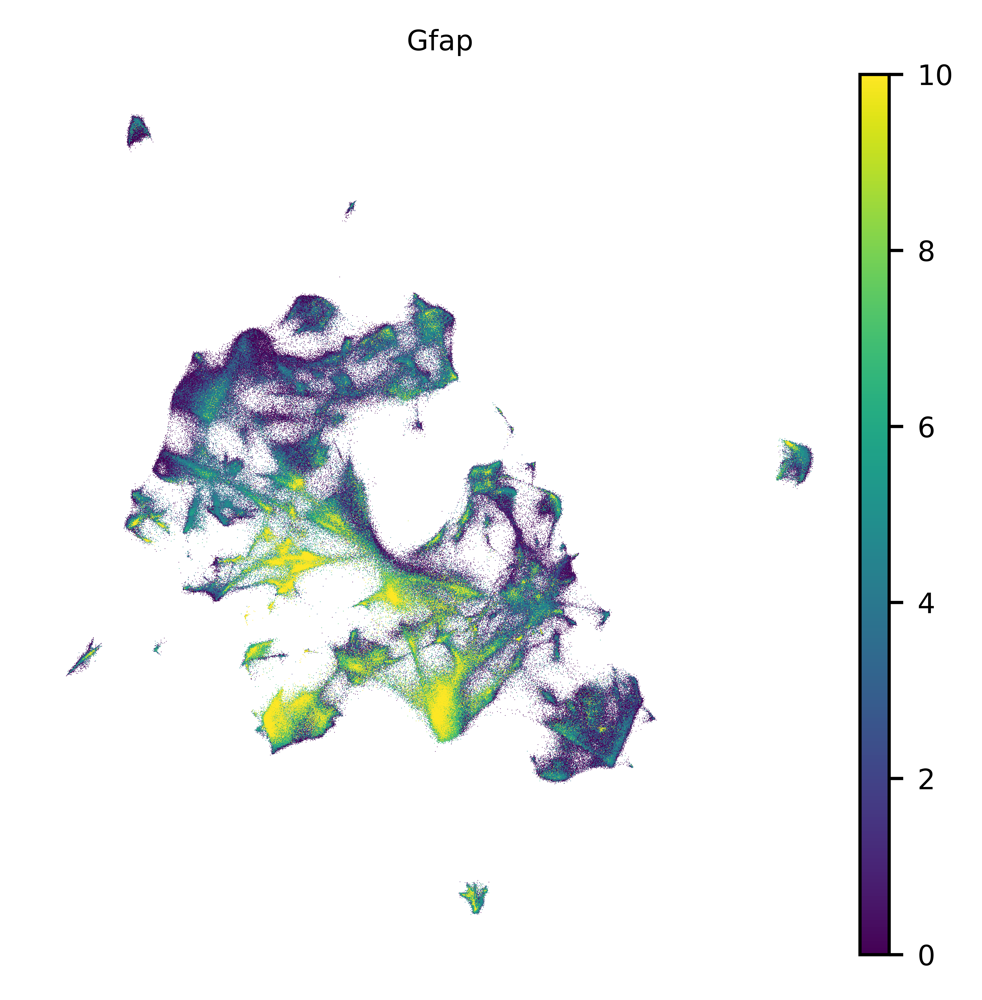

In [70]:
sc.pl.umap(adata,color='Gfap',vmax=10)

# Saving the object

In [69]:
saving_path=r'../../data/processed_adata/'
adata.write(saving_path+'/adata_multisection_expanded_3rep_withHM_withclusters.h5ad')

In [3]:
saving_path=r'../../data/processed_adata/'
adata=sc.read(saving_path+'/adata_multisection_expanded_3rep_withHM_withclusters.h5ad')

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


# DEG markers

In [ ]:
sc.tl.rank_genes_groups(adata, groupby='leiden_1_4', method='wilcoxon')
sc.tl.dendrogram(adata,groupby='leiden_1_4')
sc.pl.rank_genes_groups_dotplot(adata, n_genes=1, swap_axes=True)#,save='deg.pdf')

# Reading the object again if needed

In [4]:
saving_path=r'../../data/processed_adata/'
adata=sc.read(saving_path+'/adata_multisection_expanded_3rep_withHM_withclusters.h5ad')

In [74]:
import json
ob=open('/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/figures/2.comparison_between_datasets/polygons/regions_multisection_1.json')
js=json.load(ob)
output=pd.DataFrame(columns=['y','x','region_annotation','region_general'])
nu=0
for ob in js:
    for num in range(0,len(ob['coordinates'][0])):
        output.loc[nu,:]=list([ob['coordinates'][0][num][0],ob['coordinates'][0][num][1],ob['name'],ob['name'].replace(' [1]','').replace('D: ','')])
        nu=nu+1

from shapely.geometry import Point, Polygon
def domainassign(plsin,adatadom):
    adatadom.obs['region_annotation']='None'
    plt.figure()
    for sel in plsin['region_annotation'].unique():
        plsub=plsin[plsin['region_annotation']==sel]
        if plsub.shape[0]>2:
    #        plt.figure()
            coord = np.array(plsub[['y','x']]).tolist()
            coord.append(coord[0])
            poli=Polygon(coord)
            xs, ys = zip(*coord) #create lists of x and y values
            plt.plot(xs,ys,color='black') 
            plt.title(sel)
            for n in adatadom.obs.index:
                pnt=Point(adatadom.obs.loc[n,'y_centroid'],adatadom.obs.loc[n,'x_centroid'])
                if pnt.within(poli)==True:
                    adatadom.obs.loc[n,'region_annotation']=sel
    plt.scatter(adatadom.obs['y_centroid'],adatadom.obs['x_centroid'],s=0.5)
    plt.show() # if you need...
    return adatadom

dictio_region=dict(zip(output['region_annotation'],output['region_general']))
dictio_region['D: vl [2]']='vl'

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:13: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  del sys.path[0]


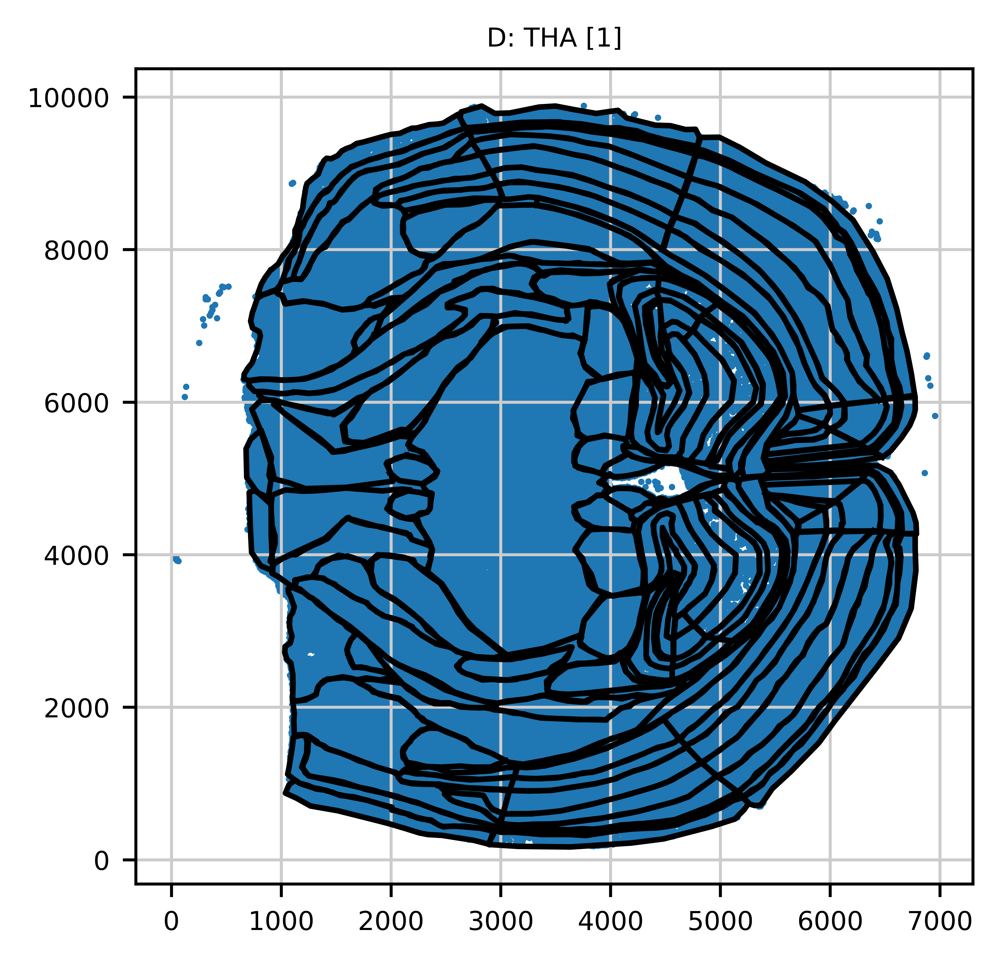

In [75]:
adata.layers['raw']=adata.raw.X
adatar1=adata[adata.obs['replicate']=='1']
pls=output
pls['x']=pls['x']*0.2125
pls['y']=pls['y']*0.2125
adatar1=domainassign(pls,adatar1)

In [71]:
adatar1.obsm['spatial']=np.array(adatar1.obs.loc[:,['x_centroid','y_centroid']])

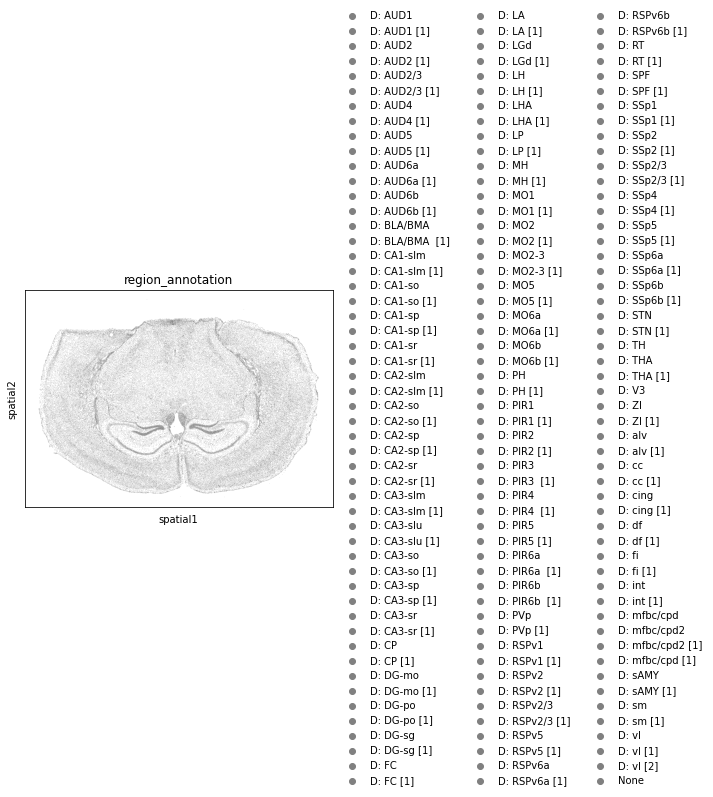

In [72]:
sc.pl.spatial(adatar1,color='region_annotation',spot_size=10)

In [207]:
nancells=adatar1[adatar1.obs['region_annotation']=='None']
annotatedcells=adatar1[adatar1.obs['region_annotation']!='None']
from tqdm import tqdm
nancells.obs['new_domain']='nan'
print('caclulating distance to vessel...')
for rd in tqdm(nancells.obs.index):
        meas=((annotatedcells.obs.X-nancells.obs.loc[rd,'X'])**2)+((annotatedcells.obs.Y-nancells.obs.loc[rd,'Y'])**2)
        nancells.obs.loc[rd,'new_domain']=meas.idxmin()
dican=dict(zip(annotatedcells.obs.index,annotatedcells.obs['region_annotation']))
nancells.obs['new_domain']=nancells.obs['new_domain'].map(dican)
new_assignment=dict(zip(nancells.obs.index,nancells.obs['new_domain']))
for indi in nancells.obs.index:
    adatar1.obs.loc[indi,'region_annotation']=new_assignment[indi]

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  after removing the cwd from sys.path.


caclulating distance to vessel...


0it [00:00, ?it/s]


In [208]:
adatar1.obs['region_level4']=adatar1.obs['region_annotation'].map(dictio_region)

In [209]:
domain_level=pd.read_csv("../../data/annotation_dictionaries/ABA_domain_annotation_dictionary_whole_coronal.csv",sep=';')

In [211]:
lv4lv3=dict(zip(domain_level['level4'],domain_level['level3']))
lv4lv2=dict(zip(domain_level['level4'],domain_level['level2']))
lv4lv1=dict(zip(domain_level['level4'],domain_level['level1']))
adatar1.obs['region_level3']=adatar1.obs['region_level4'].map(lv4lv3)
adatar1.obs['region_level2']=adatar1.obs['region_level4'].map(lv4lv2)
adatar1.obs['region_level1']=adatar1.obs['region_level4'].map(lv4lv1)

In [212]:
adatar1.obs['region_level4']=adatar1.obs['region_level4'].astype(str)

In [213]:
lv4color=dict(zip(domain_level['level4'],domain_level['color']))
lv4color['nan']='white'
adatar1.uns['region_level4_colors']=[lv4color[el] for el in np.unique(adatar1.obs['region_level4']).astype(str)]

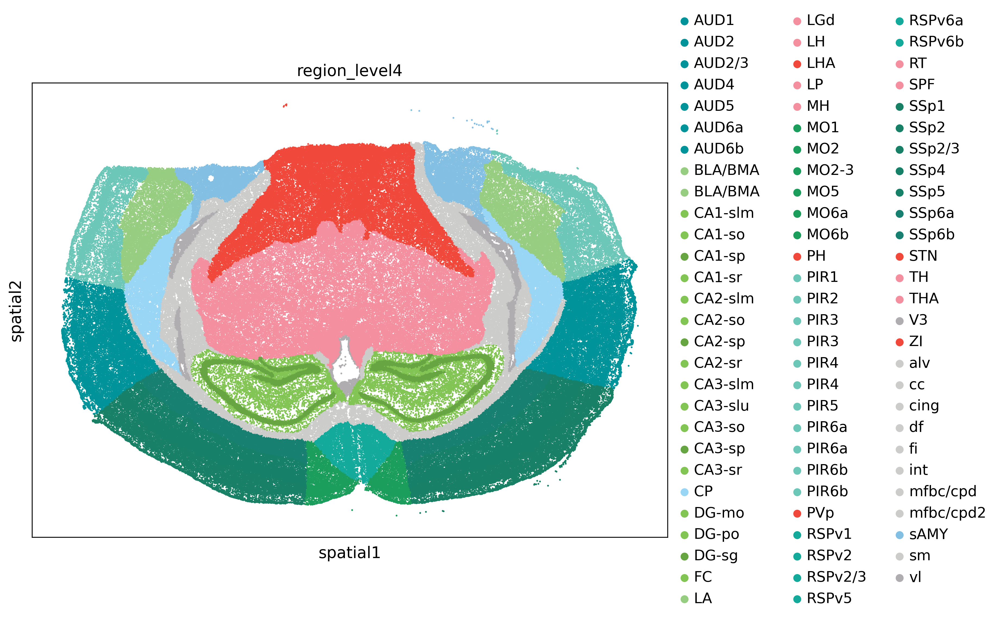

In [85]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.spatial(adatar1,color='region_level4',spot_size=30)

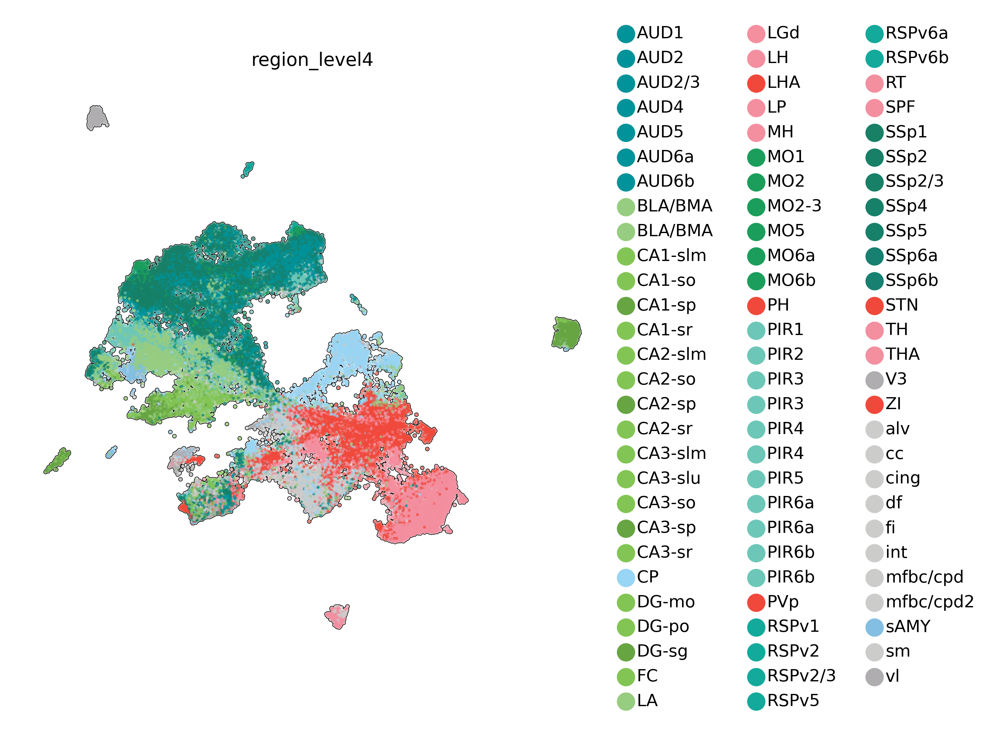

In [44]:
#listcols=[domain_color_dict[k] for k in np.unique(adatanew.obs['region_annotation'])]
#adatanew.uns['region_annotation_colors']=listcols
sc.set_figure_params(scanpy=True, dpi=300, dpi_save=300, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.pl.umap(adatar1,color=['region_level4'],size=5,add_outline=True,outline_width=[0.2,0.05],show=False)
plt.savefig('../../figures/celltype_identification_multisection/msbrain_multisection_region_level4_expanded.pdf',bbox_inches='tight')

# Saving regions

In [86]:
saving_path=r'../../data/processed_adata/'
adatar1.write(saving_path+'adata_multisection_expanded_r1_with_annotations.h5ad')

# read objects

In [6]:
saving_path=r'../../data/processed_adata/'
adatar1=sc.read(saving_path+'adata_multisection_expanded_r1_with_annotations.h5ad')

In [5]:
saving_path=r'../../data/processed_adata/'
adata_nuclei=sc.read(saving_path+'/adata_multisection_nuclei_3rep_withHM_withclusters.h5ad')

In [16]:
adata_nuclei1=adata_nuclei[adata_nuclei.obs['replicate']=='1']

In [21]:
celltypes=dict(zip(adata_nuclei1.obs['cell_id'],adata_nuclei1.obs['Class']))
adatar1.obs['Class_from_nuclei']=adatar1.obs['cell_id'].map(celltypes)
adatar1.uns['Class_from_nuclei_colors']=adata_nuclei1.uns['Class_colors']

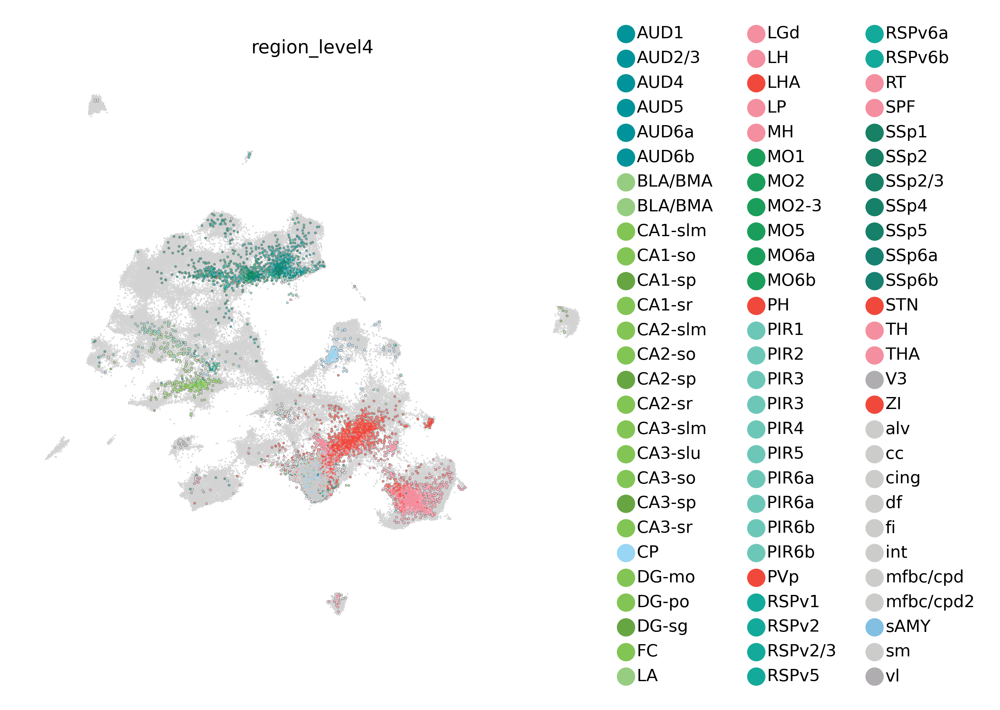

In [42]:
adata_oligo=adatar1[adatar1.obs['Class_from_nuclei']=='Oligodendrocytes']
sc.set_figure_params(scanpy=True, dpi=300, dpi_save=300, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
ax=sc.pl.umap(adatar1,size=1,add_outline=True,outline_width=[0,0],show=False)
ax=sc.pl.umap(adata_oligo,color=['region_level4'],size=2,add_outline=True,outline_width=[0.1,0.05],show=False,ax=ax)

plt.savefig('../../figures/celltype_identification_multisection/msbrain_Oligo_by_domain_Oligodendrocytes.pdf',bbox_inches='tight')

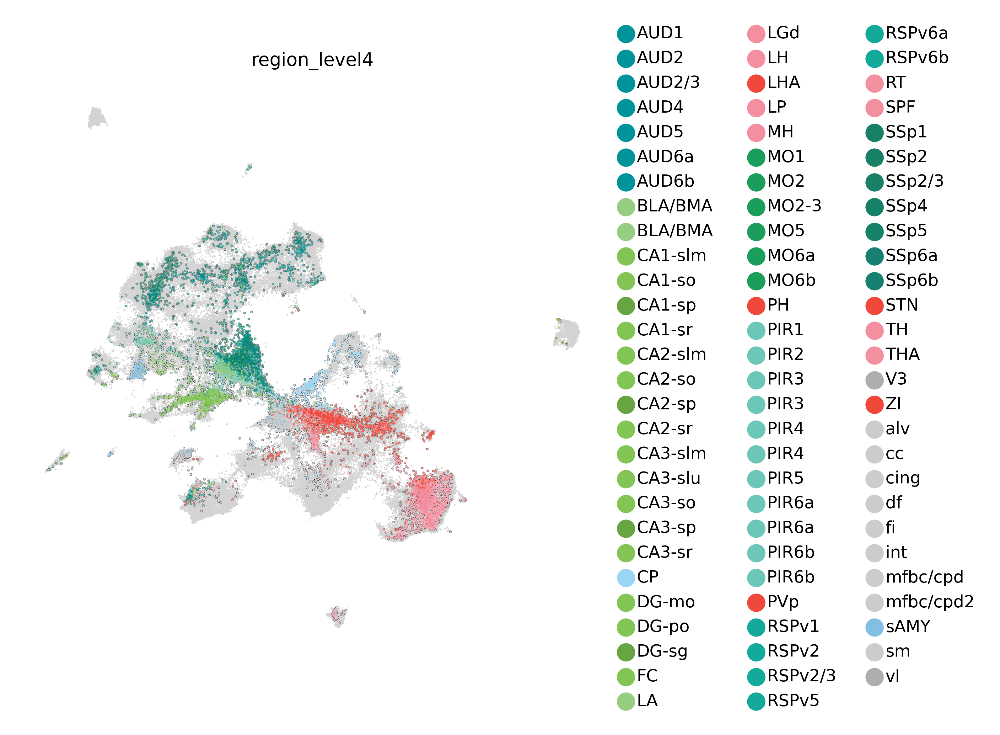

In [41]:
adata_oligo=adatar1[adatar1.obs['Class_from_nuclei']=='Astrocytes']
sc.set_figure_params(scanpy=True, dpi=300, dpi_save=300, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
ax=sc.pl.umap(adatar1,size=1,add_outline=True,outline_width=[0,0],show=False)
ax=sc.pl.umap(adata_oligo,color=['region_level4'],size=2,add_outline=True,outline_width=[0.1,0.05],show=False,ax=ax)
plt.savefig('../../figures/celltype_identification_multisection/msbrain_Oligo_by_domain_Astrocytes.pdf',bbox_inches='tight')

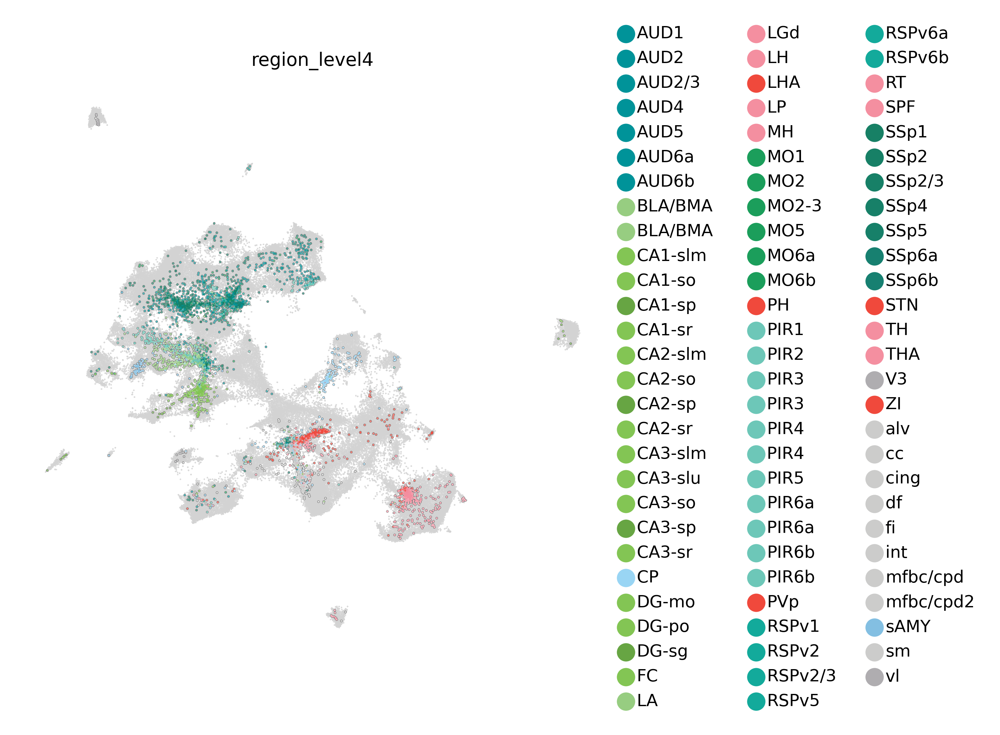

In [40]:
adata_oligo=adatar1[adatar1.obs['Class_from_nuclei']=='Microglia']
sc.set_figure_params(scanpy=True, dpi=300, dpi_save=300, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
ax=sc.pl.umap(adatar1,size=1,add_outline=True,outline_width=[0,0],show=False)
ax=sc.pl.umap(adata_oligo,color=['region_level4'],size=2,add_outline=True,outline_width=[0.1,0.05],show=False,ax=ax)
plt.savefig('../../figures/celltype_identification_multisection/msbrain_Oligo_by_domain_Microglia.pdf',bbox_inches='tight')